In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from catch22 import catch22_all
import scipy.ndimage as ndimage
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import palettable

In [32]:
criteria='new'

tc_filt=pd.read_csv(rf'C:\Users\Firefly\Desktop\MRes_231\tcs_new\tc_filt_{criteria}_criteria_standard.csv')
notes=pd.read_csv(rf'C:\Users\Firefly\Desktop\MRes_231\tcs_new\active_tcs_{criteria}_criteria_notes_standard.csv')

tc_filt=tc_filt[notes['video']=='y']
tc_filt.index=np.arange(tc_filt.shape[0])
notes=notes[notes['video']=='y']
notes.index=np.arange(notes.shape[0])

tc_filt=tc_filt.iloc[:,404:]
tc_filt

,400,401,402,403,404,405,406,407,408,409,...,4989,4990,4991,4992,4993,4994,4995,4996,4997,4998
0,1.001050,1.000649,1.000400,1.000352,1.000511,1.000847,1.001309,1.001843,1.002387,1.002868,...,1.000659,1.000590,1.000281,0.999740,0.999015,0.998180,0.997333,0.996583,0.996024,0.995728
1,0.998727,0.999083,0.999379,0.999562,0.999608,0.999533,0.999382,0.999198,0.998999,0.998775,...,0.999670,0.999675,0.999982,1.000552,1.001265,1.001955,1.002485,1.002796,1.002922,1.002950
2,0.996362,0.996253,0.996217,0.996200,0.996152,0.996043,0.995864,0.995626,0.995360,0.995111,...,1.000730,1.000810,1.000740,1.000477,1.000057,0.999574,0.999135,0.998814,0.998628,0.998551
3,1.000224,1.000362,1.000508,1.000608,1.000652,1.000664,1.000691,1.000772,1.000924,1.001140,...,0.997312,0.997865,0.998352,0.998697,0.998889,0.998979,0.999036,0.999109,0.999194,0.999255
4,0.998034,0.997603,0.997101,0.996604,0.996188,0.995904,0.995765,0.995748,0.995818,0.995948,...,1.001234,1.001212,1.001344,1.001601,1.001928,1.002253,1.002507,1.002655,1.002712,1.002720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,1.001355,1.001310,1.001157,1.000960,1.000806,1.000772,1.000889,1.001144,1.001482,1.001835,...,1.003766,1.003980,1.004167,1.004315,1.004424,1.004507,1.004577,1.004638,1.004686,1.004712
283,1.000191,1.000334,1.000362,1.000263,1.000049,0.999744,0.999386,0.999015,0.998670,0.998371,...,0.999357,0.999276,0.999142,0.999040,0.999052,0.999219,0.999528,0.999912,1.000263,1.000473
284,0.999597,0.999601,0.999492,0.999262,0.998965,0.998698,0.998557,0.998591,0.998775,0.999025,...,1.003207,1.003482,1.003802,1.004109,1.004331,1.004397,1.004281,1.004026,1.003740,1.003553
285,0.998947,0.999627,1.000309,1.000840,1.001109,1.001079,1.000781,1.000294,0.999709,0.999100,...,1.006852,1.006510,1.006241,1.006033,1.005837,1.005589,1.005245,1.004828,1.004433,1.004189


In [19]:
#Feature Extraction
features=pd.DataFrame([])
for i in range(tc_filt.shape[0]):
    df=tc_filt.iloc[i,:]
    #Feature Extraction
    catch22_out=catch22_all(df)
    features=features.append(catch22_out,ignore_index=True)
values=features['values'].apply(pd.Series)
values.columns=['DN_HistogramMode_5','DN_HistogramMode_10','CO_f1ecac','CO_FirstMin_ac','CO_HistogramAMI_even_2_5','CO_trev_1_num','MD_hrv_classic_pnn40','SB_BinaryStats_mean_longstretch1','SB_TransitionMatrix_3ac_sumdiagcov','PD_PeriodicityWang_th0_01','CO_Embed2_Dist_tau_d_expfit_meandiff','IN_AutoMutualInfoStats_40_gaussian_fmmi','FC_LocalSimple_mean1_tauresrat','DN_OutlierInclude_p_001_mdrmd','DN_OutlierInclude_n_001_mdrmd','SP_Summaries_welch_rect_area_5_1','SB_BinaryStats_diff_longstretch0','SB_MotifThree_quantile_hh','SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1','SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1','SP_Summaries_welch_rect_centroid','FC_LocalSimple_mean3_stderr']

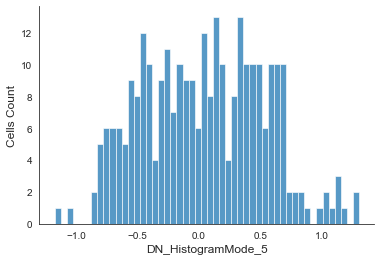

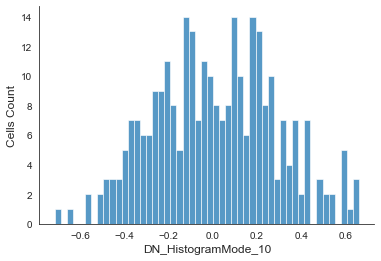

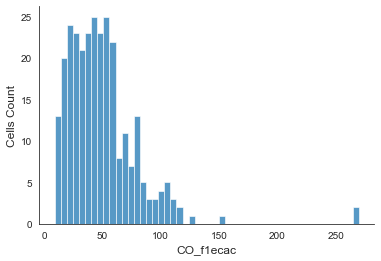

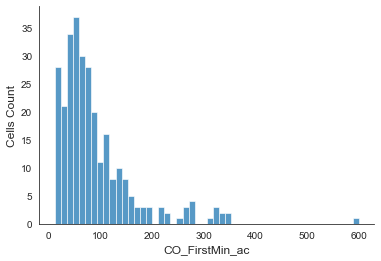

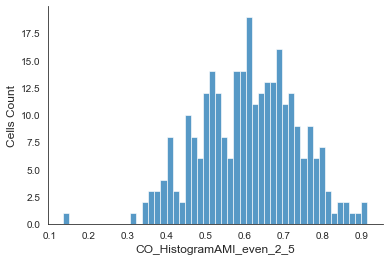

...

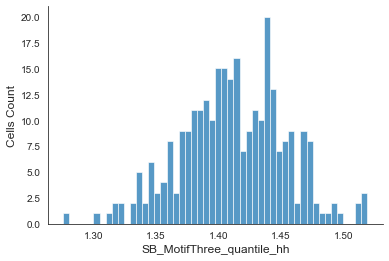

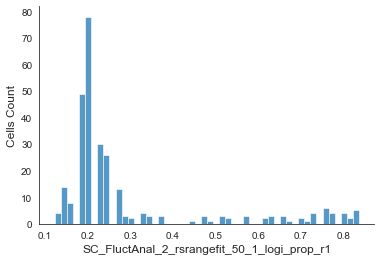

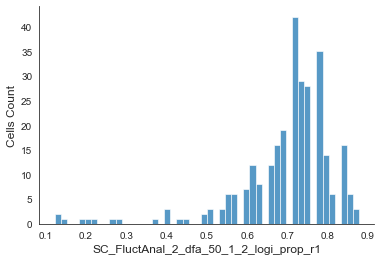

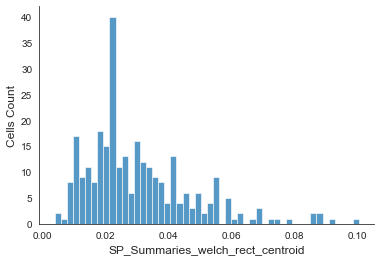

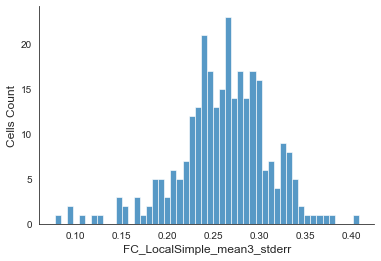

In [20]:
#Raw data distribution
for i in range(values.shape[1]):
    #plt.figure(dpi=300)
    sns.histplot(values.iloc[:,i],bins=50)
    sns.despine(top=True, right=True, left=False, bottom=False)
    sns.set_style('white')
    #plt.title(values.columns[i])
    plt.xlabel(values.columns[i],fontsize=12)
    plt.ylabel('Cells Count',fontsize=12)
    plt.show()

In [21]:
values[values['IN_AutoMutualInfoStats_40_gaussian_fmmi']==40].shape[0]
values.shape[0]

287

In [22]:
#Remove the least informative one    
f=values
f=f.drop(['IN_AutoMutualInfoStats_40_gaussian_fmmi'],axis=1)

#Normalization: Scale[0.0001,1]+Boxcox+Scale[0,1] and check the normalized distribution
import scipy.stats as spstats
min_max_scaler = MinMaxScaler(feature_range=(0.0001,1))
fb = min_max_scaler.fit_transform(f)
fb=pd.DataFrame(fb)

for i in range(f.shape[1]):
    feature=np.array(fb.iloc[:,i])
    l,opt_lambda=spstats.boxcox(feature)
    #print('Optimal lambda value:', opt_lambda)
    f.iloc[:,i]=spstats.boxcox(fb.iloc[:,i],lmbda=opt_lambda)

fb= MinMaxScaler(feature_range=(0,1)).fit_transform(f)
fb= pd.DataFrame(fb)
fb.columns=['DN_HistogramMode_5','DN_HistogramMode_10','CO_f1ecac','CO_FirstMin_ac','CO_HistogramAMI_even_2_5',
            'CO_trev_1_num','MD_hrv_classic_pnn40','SB_BinaryStats_mean_longstretch1','SB_TransitionMatrix_3ac_sumdiagcov',
            'PD_PeriodicityWang_th0_01','CO_Embed2_Dist_tau_d_expfit_meandiff','FC_LocalSimple_mean1_tauresrat',
            'DN_OutlierInclude_p_001_mdrmd','DN_OutlierInclude_n_001_mdrmd','SP_Summaries_welch_rect_area_5_1',
            'SB_BinaryStats_diff_longstretch0','SB_MotifThree_quantile_hh','SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1',
            'SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1','SP_Summaries_welch_rect_centroid','FC_LocalSimple_mean3_stderr']

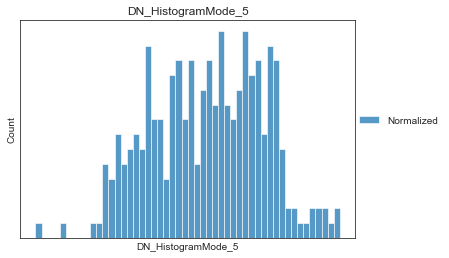

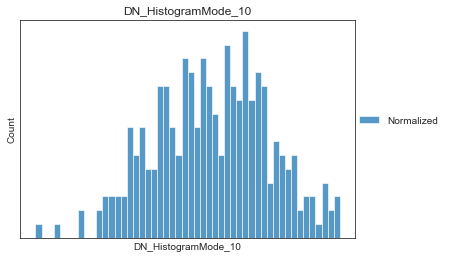

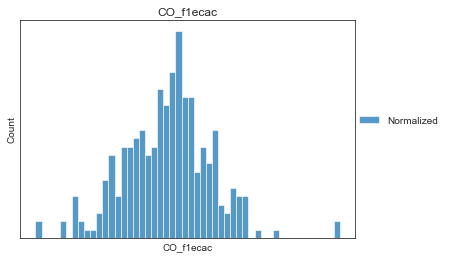

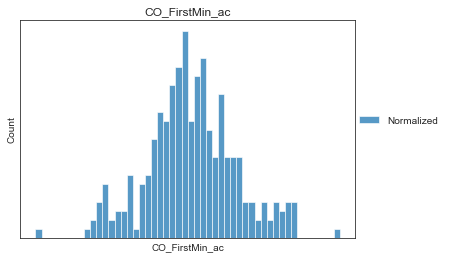

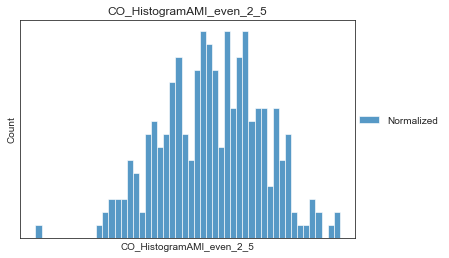

...

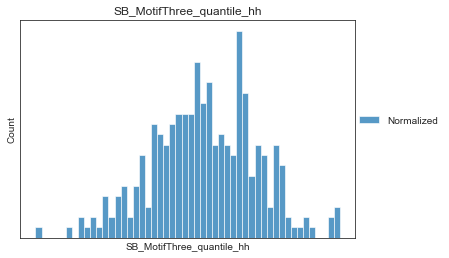

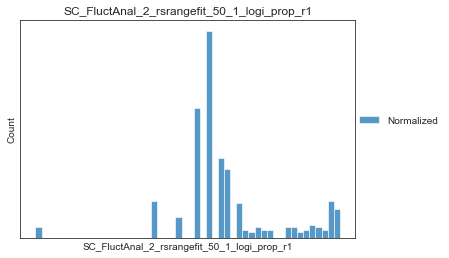

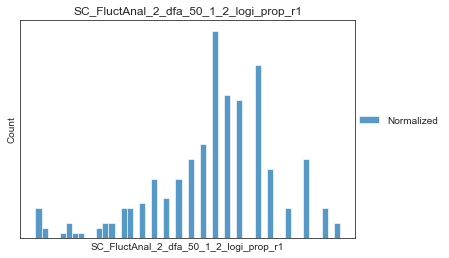

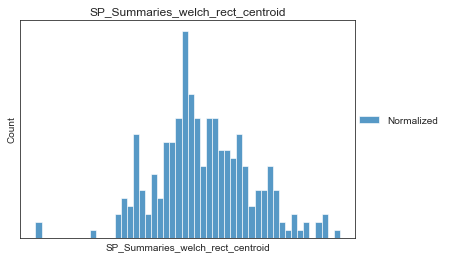

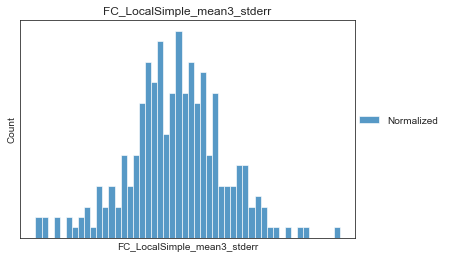

In [23]:
for i in range(fb.shape[1]):
    #plt.figure(dpi=600)
    #sns.kdeplot(f.iloc[:,i],label='Original')
    sns.histplot(fb.iloc[:,i],label='Normalized',bins=50)
    #sns.despine(top=True, right=True, left=False, bottom=False)
    sns.set_style('white')
    plt.xticks([])
    plt.yticks([])
    plt.title(fb.columns[i])
    #plt.ylabel('Number')
    #plt.xlabel(fb.columns[i])
    #plt.savefig(fb.columns[i])
    plt.legend(loc=[1,0.5],frameon=False)
    plt.show()

plt.figure(figsize=(15,20),dpi=300)
for i in range(fb.shape[1]):
    
    # Set up the plot
    plt.subplot(7, 3, i+1)
    
    # Draw the plot
    sns.kdeplot(f.iloc[:,i],label='Original')
    sns.kdeplot(fb.iloc[:,i],label='Normalized')
    sns.despine(top=True, right=True, left=False, bottom=False)
    sns.set_style('white')
    # Title and labels
    plt.title(fb.columns[i],fontsize=20)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(None)
    plt.ylabel(None)
    #plt.legend(loc=[1,0.4],frameon=False)

plt.tight_layout()
plt.show()

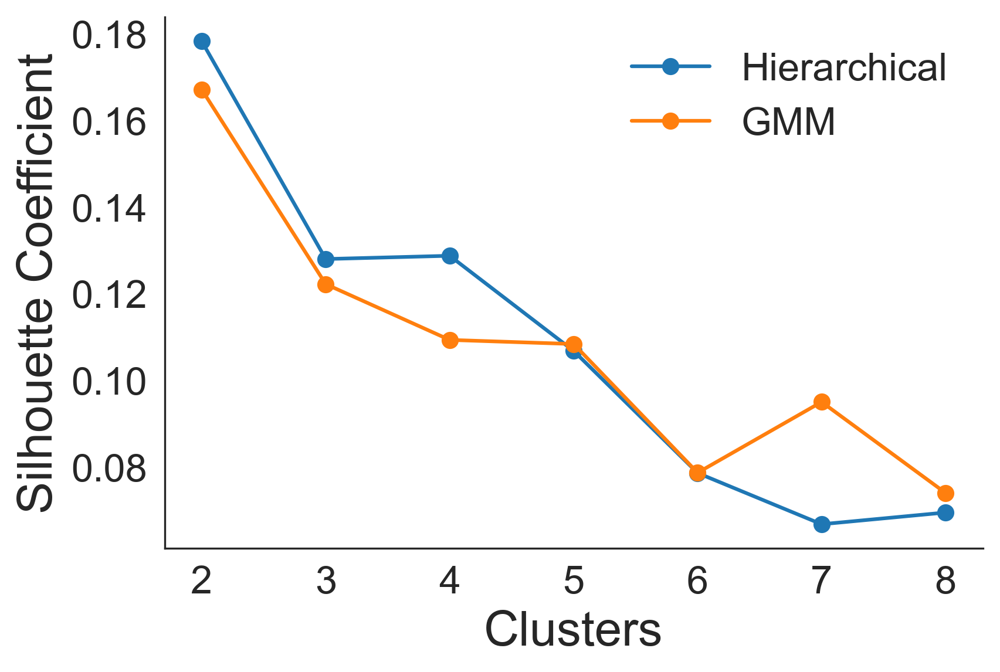

In [24]:
# Estimate k using Silhouette Coefficient - Intercluster similarity
# Comparing Hierarchical and GMM
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.mixture import GaussianMixture as GMM
good_fb = fb
Scores = []  
g=[]
for k in range(2,9):
    estimator = AgglomerativeClustering(n_clusters=k,linkage='ward')  # 构造聚类器
    estimator.fit(good_fb)
    Scores.append(silhouette_score(good_fb,estimator.labels_,metric='euclidean'))
    estimator_g = GMM(n_components=k, random_state=0)
    estimator_g.fit(good_fb)
    g.append(silhouette_score(good_fb,estimator_g.predict(good_fb),metric='euclidean'))

X = range(2,9)
plt.figure(dpi=300,facecolor='white')
#plt.figure()
plt.xlabel('Clusters',fontsize=20)
plt.ylabel('Silhouette Coefficient',fontsize=20)
plt.plot(X,Scores,'o-',label='Hierarchical')
plt.plot(X,g,'o-',label='GMM')
#plt.title('Silhoutte')
plt.legend(fontsize=16,frameon=False)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
#plt.axes().yaxis.set_tick_params(which='major', left = 'off')
#plt.axes().xaxis.set_tick_params(which='major', bottom = 'off')
#plt.savefig('silhouette coef.pdf',format='pdf',bbox_inches='tight',dpi=300)
plt.show()

In [26]:
with open("fig4__4D_GMM.txt", "w") as output:
    output.write(str(g))
with open("ffig4__4D_Hierarchical.txt", "w") as output:
    output.write(str(Scores))

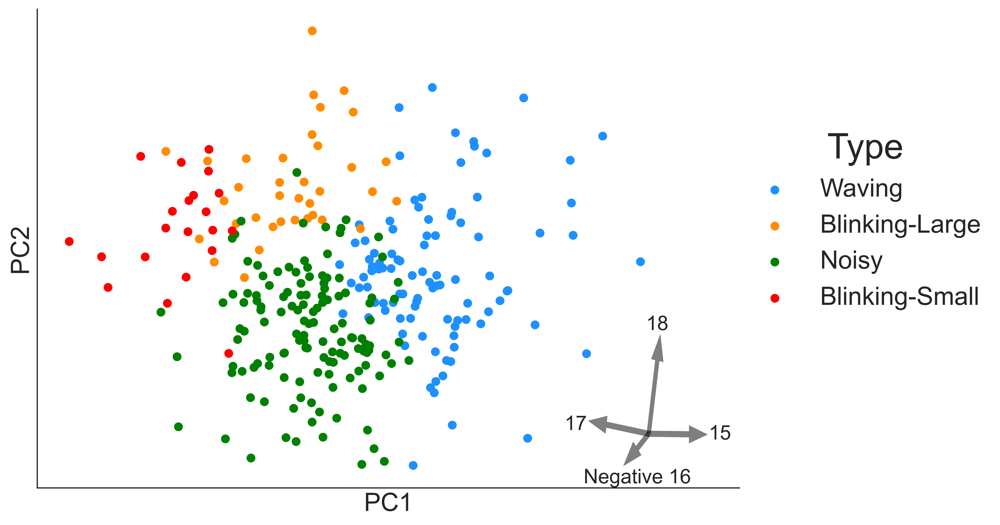

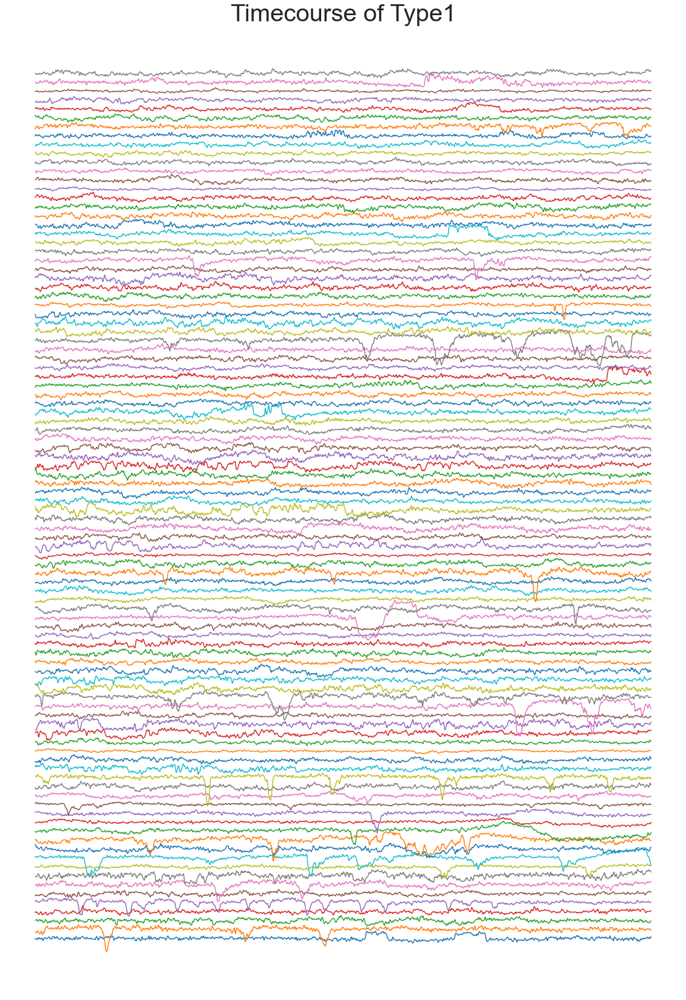

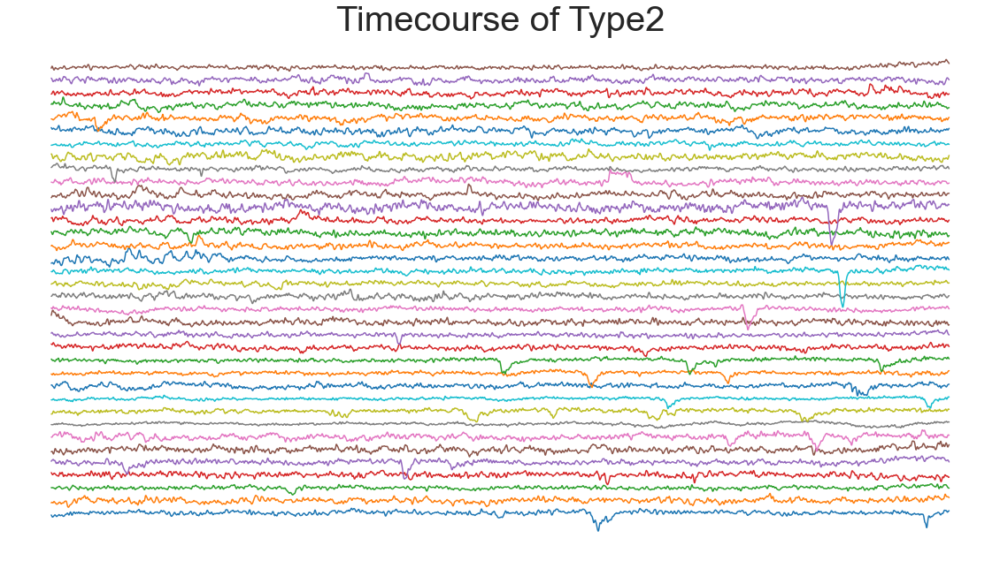

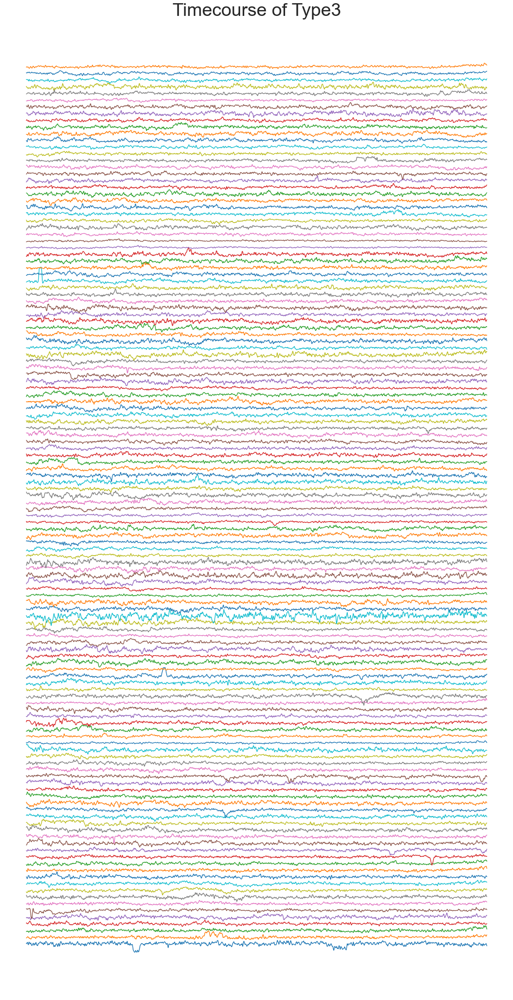

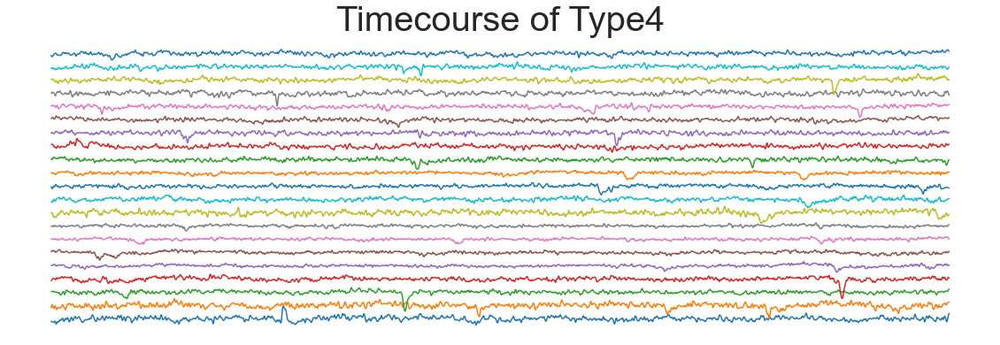

In [33]:
# Hierarchical clustering
T=0.2
from sklearn.cluster import AgglomerativeClustering

n_clusters=4
clustering = AgglomerativeClustering(linkage='ward',n_clusters=n_clusters).fit(fb)

clustering.labels_

ts=tc_filt
pca = PCA(n_components=0.8)
new_pca = pd.DataFrame(pca.fit_transform(fb))
importance = pca.explained_variance_ratio_
c=pca.components_

output_data = pd.concat([ pd.Series(clustering.labels_, index=fb.index),fb], axis=1)   # Output with group information
output_data.columns = ['Type']+list(fb.columns)  # Rename columns
output_ts = pd.concat([pd.Series(clustering.labels_, index=ts.index),ts], axis=1)   # Output with group information
output_ts.columns = ['Type'] + list(ts.columns)   # Rename columns

#output_data.to_csv('fb with label.csv')
#output_ts.to_csv('tc_filt with label.csv')

fig=plt.figure(figsize=(10,7),dpi=600)
ax=fig.add_subplot(111)
ax.set_facecolor('white')
title=['Waving','Blinking-Large','Noisy','Blinking-Small']
#title=['Quiet','Waving','Noisy','Blinking-S','Blinking-L']
color=['dodgerblue','darkorange','green','red','mediumpurple']
for i in range(n_clusters):
    t=new_pca[output_data['Type']==i]
    ax.scatter(t.iloc[:,0],t.iloc[:,1],label=title[i],marker='o',color=color[i])

plt.legend(fontsize=20,frameon=False,loc=[1,0.35],ncol=1,title='Type',title_fontsize=28,columnspacing=0.1)
plt.xticks([])
plt.yticks([])
#plt.title('PCA-231-Hierarchical')
kwargs={'linestyle':'-', 'lw':0.1, 'width':0.02} 
    
for i in [14]:
    ax.arrow(1.5,-0.5,c[0,i]*0.6,c[1,i]*0.6,alpha=0.5,ec='black',fc='black',**kwargs)
    ax.text(c[0,i]*0.6+1.65,c[1,i]*0.6-0.5,f'{i+1}', ha="center", va="center",fontsize=16)
for i in [17]:
    ax.arrow(1.5,-0.5,c[0,i]*0.6,c[1,i]*0.6,alpha=0.5,ec='black',fc='black',**kwargs)
    ax.text(c[0,i]*0.6+1.5,c[1,i]*0.6-0.38,f'{i+1}', ha="center", va="center",fontsize=16)
for i in [16]:
    ax.arrow(1.5,-0.5,c[0,i]*0.6,c[1,i]*0.6,alpha=0.5,ec='black',fc='black',**kwargs)
    ax.text(c[0,i]*0.6+1.35,c[1,i]*0.6-0.5,f'{i+1}', ha="center", va="center",fontsize=16)
for i in [15]:
    ax.arrow(1.5,-0.5,-c[0,i]*0.6,-c[1,i]*0.6,alpha=0.5,ec='black',fc='black',**kwargs)
    ax.text(-c[0,i]*0.6+1.5,-c[1,i]*0.6-0.6,f'Negative {i+1}', ha="center", va="center",fontsize=16)
ax.set_xlabel(f'PC1',fontsize=20)  
ax.set_ylabel(f'PC2',fontsize=20)
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
#plt.savefig('PCA of 231.png',dpi=600)
#plt.savefig('PCA of 231.eps',format='eps',dpi=300)
#ax.spines['left'].set_linewidth(3)
#ax.spines['bottom'].set_linewidth(3)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
#plt.savefig('pca of 231.pdf',format='pdf',bbox_inches = 'tight',dpi=300)
# Plot the traces in each type
for i in range(n_clusters):
    g=output_ts[output_ts['Type']==i].iloc[:,1:]
    
    fig,ax=plt.subplots(figsize=(20,g.shape[0]*0.3))
    ax.plot(np.arange(g.shape[1])*T,g.T + np.arange(g.shape[0])/70)
    ax.set_title(f'Timecourse of Type{i+1}',fontsize=40)
    #ax.set_xlabel('Time(s)',fontsize=30)
    #ax.set_ylabel('Fluorescence df/F',fontsize=30)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.spines['left'].set_color('none')
    ax.spines['bottom'].set_color('none')
    ax.axis('off')

In [34]:
a=[False,False,True,False,False,False]
b=[14,17,15,16,14]
#by=[fb.columns[],fb.columns[11],fb.columns[15],fb.columns[16]]

#title=['Blinking-Small','Waving','Noisy','Blinking-Large']
for i in range(n_clusters):
    f=output_data[output_data['Type']==i].iloc[:,1:]
    f=f.sort_values(by=fb.columns[b[i]],axis=0,ascending=a[i])
    t=output_ts.iloc[f.index[0:],1:]
    #t.to_csv(f'tc_class_{i+1}.csv')

In [35]:
output_data

,Type,DN_HistogramMode_5,DN_HistogramMode_10,CO_f1ecac,CO_FirstMin_ac,CO_HistogramAMI_even_2_5,CO_trev_1_num,MD_hrv_classic_pnn40,SB_BinaryStats_mean_longstretch1,SB_TransitionMatrix_3ac_sumdiagcov,...,FC_LocalSimple_mean1_tauresrat,DN_OutlierInclude_p_001_mdrmd,DN_OutlierInclude_n_001_mdrmd,SP_Summaries_welch_rect_area_5_1,SB_BinaryStats_diff_longstretch0,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr
0,2,0.555256,0.809969,0.450699,0.664028,0.456235,0.524261,0.548771,0.267130,0.603955,...,0.559541,0.569712,0.699261,0.570460,0.439892,0.646971,0.568405,0.542722,0.512771,0.449788
1,0,0.316482,0.368342,0.596448,0.784659,0.696963,0.478107,0.308433,0.556696,0.423446,...,0.527974,0.638698,0.723134,0.757165,0.578938,0.574833,0.985451,0.586131,0.339181,0.299223
2,0,0.837137,0.785394,0.401272,0.552812,0.371566,0.434819,0.178450,0.552997,0.574963,...,0.631909,0.434949,0.445042,0.686354,0.466140,0.616977,0.857519,0.288818,0.545133,0.211754
3,0,0.530728,0.734766,0.460656,0.621553,0.743912,0.452959,0.477840,0.587127,0.467377,...,0.551733,0.572062,0.647552,0.690306,0.381684,0.397409,0.962269,0.461323,0.448143,0.378884
4,1,0.942697,0.959888,0.418699,0.607933,0.370373,0.542805,0.363609,0.271127,0.490096,...,0.595004,0.624650,0.714680,0.730493,0.411874,0.667333,0.890029,0.387063,0.529293,0.360693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,2,0.606267,0.458488,0.435129,0.563689,0.722052,0.509745,0.536301,0.479020,0.558380,...,0.440869,0.542342,0.421608,0.574858,0.672107,0.418354,0.568405,0.778116,0.529293,0.406742
283,0,0.405785,0.552229,0.661373,0.723706,0.653245,0.482502,0.317976,0.592323,0.793112,...,0.466518,0.719688,0.720049,0.798032,0.312157,0.472116,0.000000,1.000000,0.353604,0.301288
284,0,0.544993,0.758523,0.450699,0.531755,0.751329,0.520763,0.511130,0.470271,0.600410,...,0.530212,0.663448,0.638068,0.710043,0.536843,0.400435,0.977914,0.586131,0.495481,0.369753
285,1,0.444861,0.644415,0.554084,0.395869,0.399860,0.521685,0.675951,0.602569,0.730834,...,0.373834,0.987910,0.584202,0.417061,0.348743,0.795148,0.568405,0.000367,0.504228,0.573501


In [36]:
fb

,DN_HistogramMode_5,DN_HistogramMode_10,CO_f1ecac,CO_FirstMin_ac,CO_HistogramAMI_even_2_5,CO_trev_1_num,MD_hrv_classic_pnn40,SB_BinaryStats_mean_longstretch1,SB_TransitionMatrix_3ac_sumdiagcov,PD_PeriodicityWang_th0_01,...,FC_LocalSimple_mean1_tauresrat,DN_OutlierInclude_p_001_mdrmd,DN_OutlierInclude_n_001_mdrmd,SP_Summaries_welch_rect_area_5_1,SB_BinaryStats_diff_longstretch0,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr
0,0.555256,0.809969,0.450699,0.664028,0.456235,0.524261,0.548771,0.267130,0.603955,0.880975,...,0.559541,0.569712,0.699261,0.570460,0.439892,0.646971,0.568405,0.542722,0.512771,0.449788
1,0.316482,0.368342,0.596448,0.784659,0.696963,0.478107,0.308433,0.556696,0.423446,0.895082,...,0.527974,0.638698,0.723134,0.757165,0.578938,0.574833,0.985451,0.586131,0.339181,0.299223
2,0.837137,0.785394,0.401272,0.552812,0.371566,0.434819,0.178450,0.552997,0.574963,0.849445,...,0.631909,0.434949,0.445042,0.686354,0.466140,0.616977,0.857519,0.288818,0.545133,0.211754
3,0.530728,0.734766,0.460656,0.621553,0.743912,0.452959,0.477840,0.587127,0.467377,0.846766,...,0.551733,0.572062,0.647552,0.690306,0.381684,0.397409,0.962269,0.461323,0.448143,0.378884
4,0.942697,0.959888,0.418699,0.607933,0.370373,0.542805,0.363609,0.271127,0.490096,0.847535,...,0.595004,0.624650,0.714680,0.730493,0.411874,0.667333,0.890029,0.387063,0.529293,0.360693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,0.606267,0.458488,0.435129,0.563689,0.722052,0.509745,0.536301,0.479020,0.558380,0.559006,...,0.440869,0.542342,0.421608,0.574858,0.672107,0.418354,0.568405,0.778116,0.529293,0.406742
283,0.405785,0.552229,0.661373,0.723706,0.653245,0.482502,0.317976,0.592323,0.793112,0.984003,...,0.466518,0.719688,0.720049,0.798032,0.312157,0.472116,0.000000,1.000000,0.353604,0.301288
284,0.544993,0.758523,0.450699,0.531755,0.751329,0.520763,0.511130,0.470271,0.600410,0.597363,...,0.530212,0.663448,0.638068,0.710043,0.536843,0.400435,0.977914,0.586131,0.495481,0.369753
285,0.444861,0.644415,0.554084,0.395869,0.399860,0.521685,0.675951,0.602569,0.730834,0.408457,...,0.373834,0.987910,0.584202,0.417061,0.348743,0.795148,0.568405,0.000367,0.504228,0.573501


([], [])

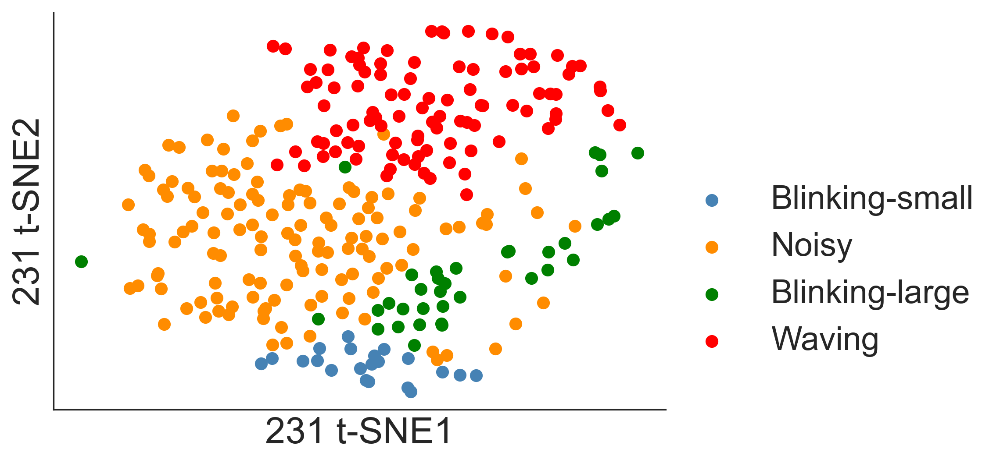

In [37]:
from sklearn.manifold import TSNE

tsne=TSNE()
new_tsne = pd.DataFrame(tsne.fit_transform(fb))
#notes['condition']=notes['expt']

t_w=new_tsne[output_ts['Type']==0]
t_bl=new_tsne[output_ts['Type']==1]
t_n=new_tsne[output_ts['Type']==2]
t_bs=new_tsne[output_ts['Type']==3]


fig=plt.figure(dpi=300)
ax=fig.add_subplot(111)
#color=['lightcoral','indianred','brown','maroon']
color=['steelblue','darkorange','green','red']
ax.scatter(t_bs.iloc[:,0],t_bs.iloc[:,1],label='Blinking-small',marker='o',color=color[0])
ax.scatter(t_n.iloc[:,0],t_n.iloc[:,1],label='Noisy',marker='o',color=color[1])
ax.scatter(t_bl.iloc[:,0],t_bl.iloc[:,1],label='Blinking-large',marker='o',color=color[2])
ax.scatter(t_w.iloc[:,0],t_w.iloc[:,1],label='Waving',marker='o',color=color[3])

#ax.set_xlim([-1.5,1.5])
#ax.set_ylim([-0.75,1.25])
plt.xlabel(r'231 t-SNE1',fontsize=20)  
plt.ylabel(r'231 t-SNE2',fontsize=20)
plt.legend(fontsize=18,frameon=False,loc=[1,0.1])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.xticks([])
plt.yticks([])
#plt.savefig('combine tsne space.eps',format='eps',dpi=600)
#plt.savefig('combine tsne space.png',dpi=600)

([], [])

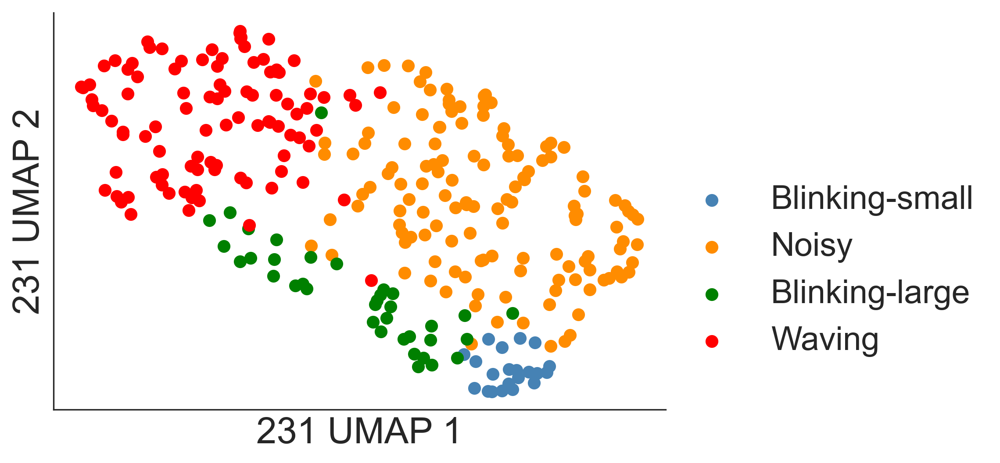

In [38]:
import umap
reducer = umap.UMAP(random_state=42)
embedding = pd.DataFrame(reducer.fit_transform(fb))
#print(embedding.shape)

t_w=embedding[output_ts['Type']==0]
t_bl=embedding[output_ts['Type']==1]
t_n=embedding[output_ts['Type']==2]
t_bs=embedding[output_ts['Type']==3]


fig=plt.figure(dpi=300)
ax=fig.add_subplot(111)
#color=['lightcoral','indianred','brown','maroon']
color=['steelblue','darkorange','green','red']
ax.scatter(t_bs.iloc[:,0],t_bs.iloc[:,1],label='Blinking-small',marker='o',color=color[0])
ax.scatter(t_n.iloc[:,0],t_n.iloc[:,1],label='Noisy',marker='o',color=color[1])
ax.scatter(t_bl.iloc[:,0],t_bl.iloc[:,1],label='Blinking-large',marker='o',color=color[2])
ax.scatter(t_w.iloc[:,0],t_w.iloc[:,1],label='Waving',marker='o',color=color[3])

#ax.set_xlim([-1.5,1.5])
#ax.set_ylim([-0.75,1.25])
plt.xlabel(r'231 UMAP 1',fontsize=20)  
plt.ylabel(r'231 UMAP 2',fontsize=20)
plt.legend(fontsize=18,frameon=False,loc=[1,0.1])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.xticks([])
plt.yticks([])
#plt.savefig('combine tsne space.eps',format='eps',dpi=600)
#plt.savefig('combine tsne space.png',dpi=600)

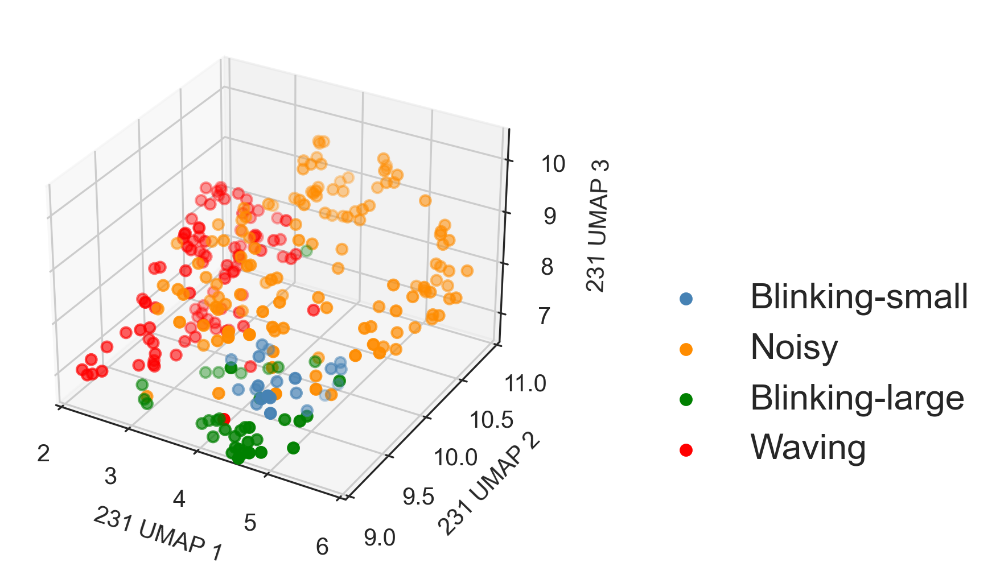

In [39]:
from mpl_toolkits.mplot3d import Axes3D
reducer = umap.UMAP(random_state=42,n_components=3)
embedding = pd.DataFrame(reducer.fit_transform(fb))
#print(embedding.shape)

t_w=embedding[output_ts['Type']==0]
t_bl=embedding[output_ts['Type']==1]
t_n=embedding[output_ts['Type']==2]
t_bs=embedding[output_ts['Type']==3]


fig=plt.figure(dpi=300)
ax = fig.add_subplot(111, projection='3d')
#color=['lightcoral','indianred','brown','maroon']
color=['steelblue','darkorange','green','red']
ax.scatter(t_bs.iloc[:,0],t_bs.iloc[:,1],t_bs.iloc[:,2],label='Blinking-small',marker='o',color=color[0])
ax.scatter(t_n.iloc[:,0],t_n.iloc[:,1],t_n.iloc[:,2],label='Noisy',marker='o',color=color[1])
ax.scatter(t_bl.iloc[:,0],t_bl.iloc[:,1],t_bl.iloc[:,2],label='Blinking-large',marker='o',color=color[2])
ax.scatter(t_w.iloc[:,0],t_w.iloc[:,1],t_w.iloc[:,2],label='Waving',marker='o',color=color[3])

ax.set_xlim([2,6])
ax.set_ylim([9,11])
ax.set_zlim([6.5,10.5])
ax.set_xlabel('231 UMAP 1')
ax.set_ylabel('231 UMAP 2')
ax.set_zlabel('231 UMAP 3')
plt.legend(fontsize=15,frameon=False,loc=[1.2,0.1])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
#plt.xticks([])
#plt.yticks([])
#plt.savefig('combine tsne space.eps',format='eps',dpi=600)
#plt.savefig('combine tsne space.png',dpi=600)

In [40]:
import plotly.express as px
df = output_data

features = df.iloc[:, 1:]

#umap_2d = UMAP(n_components=2, init='random', random_state=0)
umap_3d = umap.UMAP(n_components=3, random_state=42)

#proj_2d = umap_2d.fit_transform(features)
proj_3d = umap_3d.fit_transform(features)

#fig_2d = px.scatter(
    #proj_2d, x=0, y=1,
    #color=df.species, labels={'color': 'species'}
#)
fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=df.Type, labels={'color': 'Type'}
)
fig_3d.update_traces(marker_size=5)

#fig_2d.show()
fig_3d.write_html("file.html")
fig_3d.show()


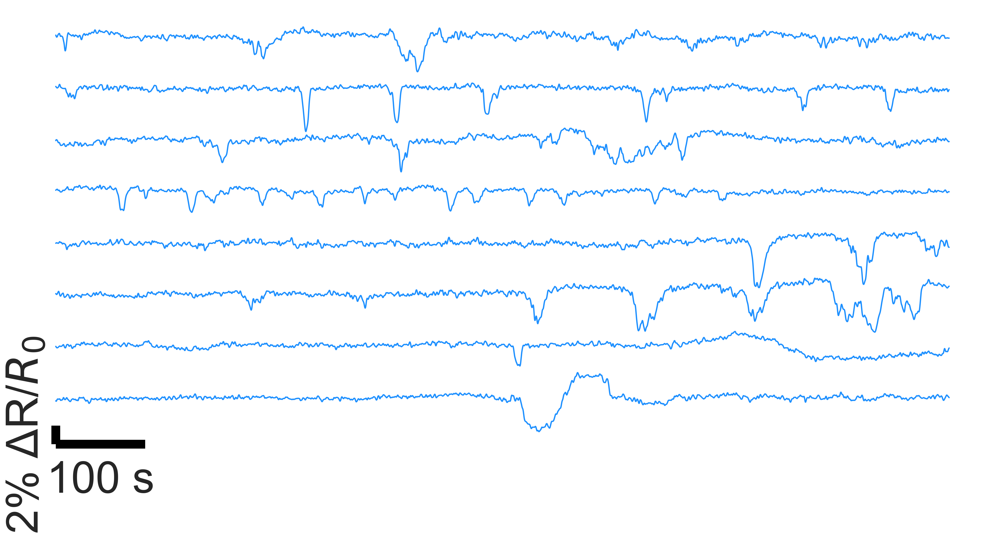

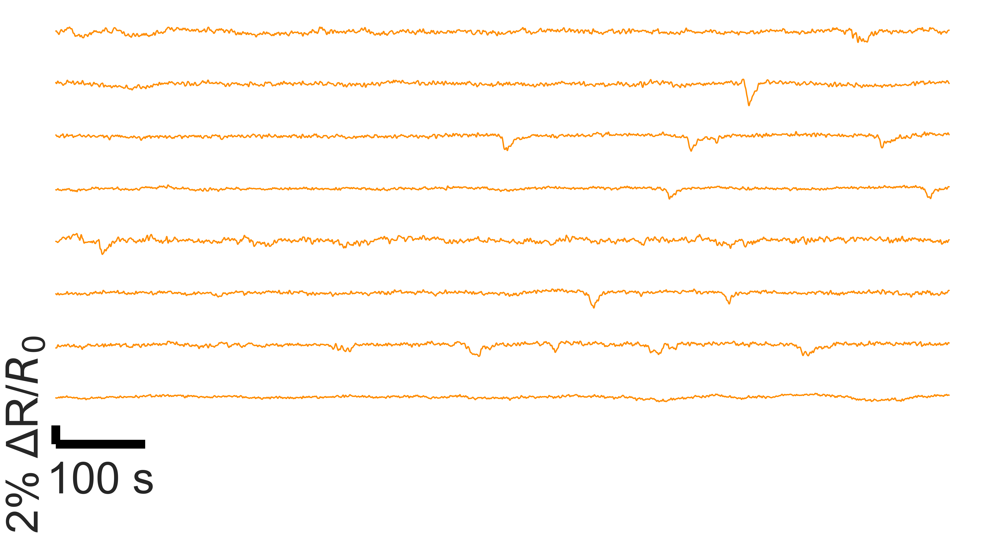

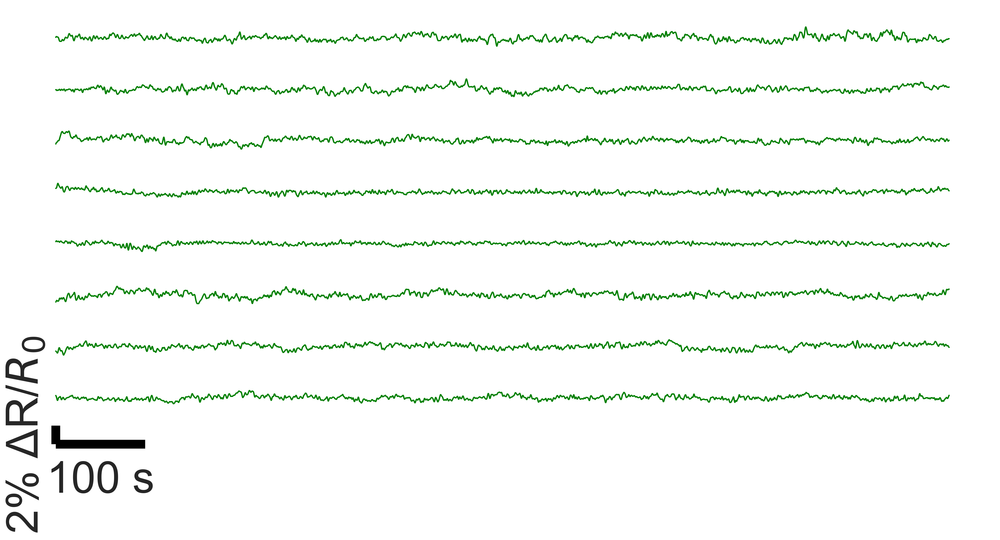

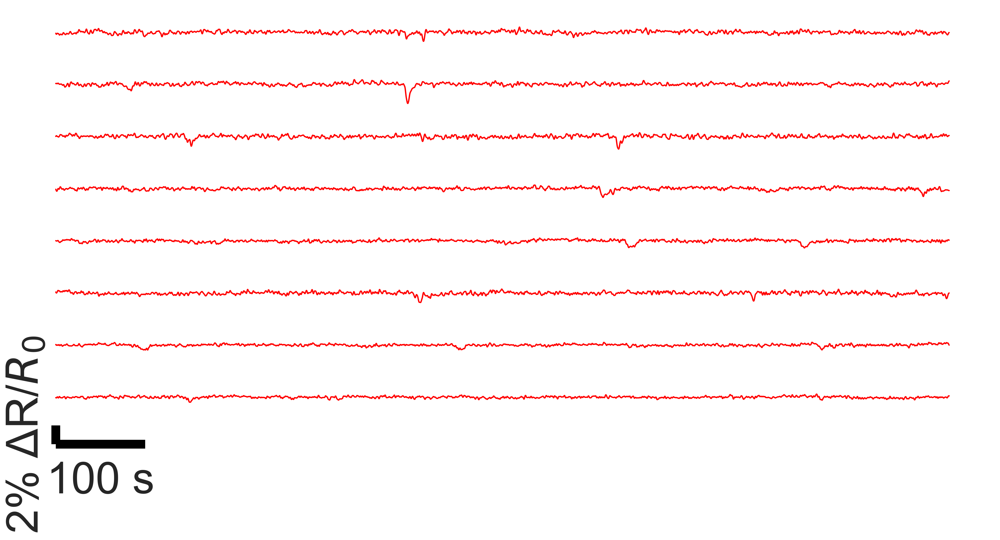

In [13]:
a=[False,False,True,False,False,False]
b=[14,17,15,16,14]
#by=[fb.columns[],fb.columns[11],fb.columns[15],fb.columns[16]]

#title=['Blinking-Small','Waving','Noisy','Blinking-Large']
for i in range(n_clusters):
    f=output_data[output_data['Type']==i].iloc[:,1:]
    f=f.sort_values(by=fb.columns[b[i]],axis=0,ascending=a[i])
    t=output_ts.iloc[f.index[0:8],1:]
    T=0.2
    ts=np.array(t)
    fig,ax=plt.subplots(figsize=(20,1.2*t.shape[0]),dpi=300)
    ax.plot(np.arange(ts.shape[1])*T,ts.T+ np.arange(ts.shape[0])/18,color=color[i])
    #ax.plot(np.arange(ts.shape[1])*T,ts.T,color=color[i])
    #ax.set_title(title[i],fontsize=26)
    #ax.set_xlabel('Time(s)')
    #ax.set_ylabel('Fluorescence df/F')
    #ax.set_xticks([])
    #ax.set_yticks([])
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.spines['left'].set_color('black')
    ax.spines['bottom'].set_color('black')
    ax.axis('off')
    ax.hlines(y=0.95, xmin=0, xmax=92, linewidth=10, color='black')
    ax.vlines(x=0, ymin=0.95, ymax=0.97, linewidth=10, color='black')
    ax.text(46,0.91,'100 s',fontsize=50,horizontalalignment='center',verticalalignment='center')
    ax.text(-30,0.96,'2% \u0394R/$R_0$',rotation=90,fontsize=50,horizontalalignment='center',verticalalignment='center')
    #plt.savefig('Reps-'+title[i]+'.png',dpi=600)
    #plt.savefig('Reps-'+title[i]+'.pdf',format='pdf',bbox_inches='tight',dpi=300)

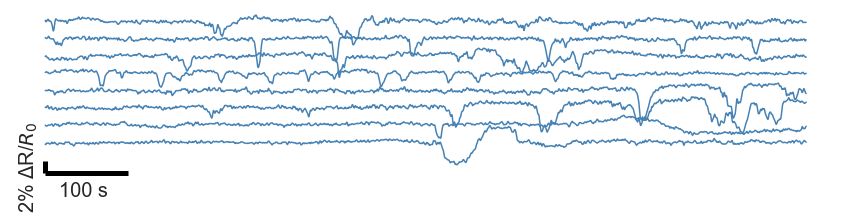

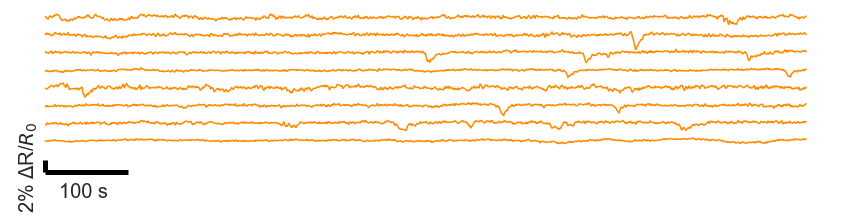

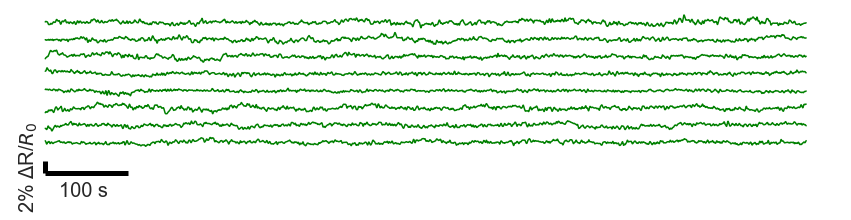

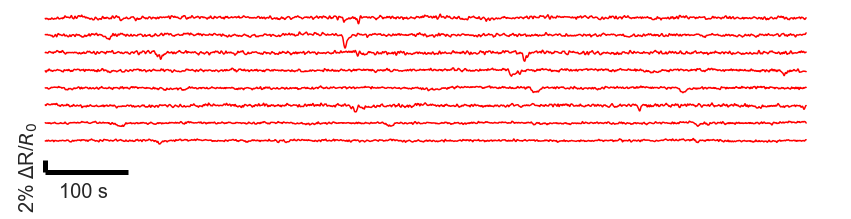

In [42]:

a=[False,False,True,False,False,False]
b=[14,17,15,16,14]

for i in range(n_clusters):
    f=output_data[output_data['Type']==i].iloc[:,1:]
    f=f.sort_values(by=fb.columns[b[i]],axis=0,ascending=a[i])
    t=output_ts.iloc[f.index[0:8],1:]
    T=0.2
    ts=np.array(t)
    fig,ax=plt.subplots(figsize=(15,0.4*t.shape[0]))
    ax.plot(np.arange(ts.shape[1])*T,ts.T+ np.arange(ts.shape[0])/36,color=color[i])
    x = np.arange(ts.shape[1])*T
    y = np.arange(ts.shape[0])/36
    np.savetxt(f'fig5___{i}_x.txt', x, delimiter=',')
    np.savetxt(f'fig5___{i}_y.txt', y, delimiter=',')
    #ax.set_title(title[i],fontsize=20)
    #ax.set_xlabel('Time(s)')
    #ax.set_ylabel('Fluorescence df/F')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.spines['left'].set_color('black')
    ax.spines['bottom'].set_color('black')
    ax.axis('off')
    ax.hlines(y=0.95, xmin=0, xmax=100, linewidth=5, color='black')
    ax.vlines(x=0, ymin=0.95, ymax=0.97, linewidth=5, color='black')
    ax.text(46,0.92,'100 s',fontsize=20,horizontalalignment='center',verticalalignment='center')
    ax.text(-20,0.96,'2% \u0394R/$R_0$',rotation=90,fontsize=20,horizontalalignment='center',verticalalignment='center')
    #plt.savefig('Reps-'+title[i]+'.pdf',format='pdf',bbox_inches='tight',dpi=300)

In [16]:
#119,31,145,29
#new_pca.to_csv(r'vm_pca_active.csv')
output_data[output_data['Type']==3]

,Type,DN_HistogramMode_5,DN_HistogramMode_10,CO_f1ecac,CO_FirstMin_ac,CO_HistogramAMI_even_2_5,CO_trev_1_num,MD_hrv_classic_pnn40,SB_BinaryStats_mean_longstretch1,SB_TransitionMatrix_3ac_sumdiagcov,...,FC_LocalSimple_mean1_tauresrat,DN_OutlierInclude_p_001_mdrmd,DN_OutlierInclude_n_001_mdrmd,SP_Summaries_welch_rect_area_5_1,SB_BinaryStats_diff_longstretch0,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr
13,3,0.450837,0.708587,0.151665,0.458678,0.324581,1.000000,0.731950,0.237166,0.522191,...,0.571971,0.482949,0.573268,0.300012,0.558312,0.742042,0.685181,0.352576,0.880289,0.708949
26,3,0.753739,0.655888,0.235162,0.455104,0.369217,0.458148,0.787747,0.271127,0.560715,...,0.533623,0.614670,0.785583,0.406882,0.270418,0.804261,0.568405,0.542722,0.766705,0.689828
27,3,0.992478,0.958996,0.235162,0.531755,0.259788,0.243907,0.657317,0.041523,0.385057,...,0.691874,0.434189,0.501035,0.498234,0.381684,0.886152,0.761993,0.423307,0.771514,0.557563
38,3,1.000000,0.997349,0.299408,0.481980,0.279905,0.436236,0.601738,0.405930,0.468566,...,0.532479,0.398012,0.569736,0.216514,0.312157,0.778376,0.661313,0.631363,0.710743,0.528752
41,3,0.894208,0.907830,0.376167,0.229091,0.378248,0.290030,0.765756,0.617596,0.549751,...,0.463666,0.815478,0.785977,0.011623,0.000000,0.812736,0.524820,0.631363,0.596125,0.684740
42,3,0.588521,0.905095,0.479676,0.469012,0.381100,0.329039,0.772652,0.485471,0.611335,...,0.424336,0.424564,0.524408,0.029859,0.000000,0.808542,0.467796,0.727344,0.495481,0.652710
44,3,0.729153,0.656928,0.269983,0.432078,0.421385,0.717734,0.816181,0.398092,0.427423,...,0.538273,0.670195,0.560522,0.000732,0.220569,0.998792,0.604119,0.461323,0.761853,0.777555
45,3,0.810394,0.763497,0.089677,0.210887,0.320673,0.375762,1.000000,0.324969,0.333390,...,0.567027,0.511851,0.602891,0.000000,0.270418,1.000000,0.524820,0.461323,0.944623,1.000000
47,3,0.765463,0.681716,0.207244,0.432078,0.382496,0.385306,0.777274,0.340933,0.445306,...,0.539455,0.680198,0.861034,0.213951,0.312157,0.844231,0.524820,0.461323,0.794956,0.740582
52,3,0.703261,0.564469,0.308352,0.465629,0.391132,0.460941,0.763467,0.202594,0.456700,...,0.501088,0.633339,0.718733,0.052411,0.348743,0.825407,0.568405,0.501123,0.699888,0.726807


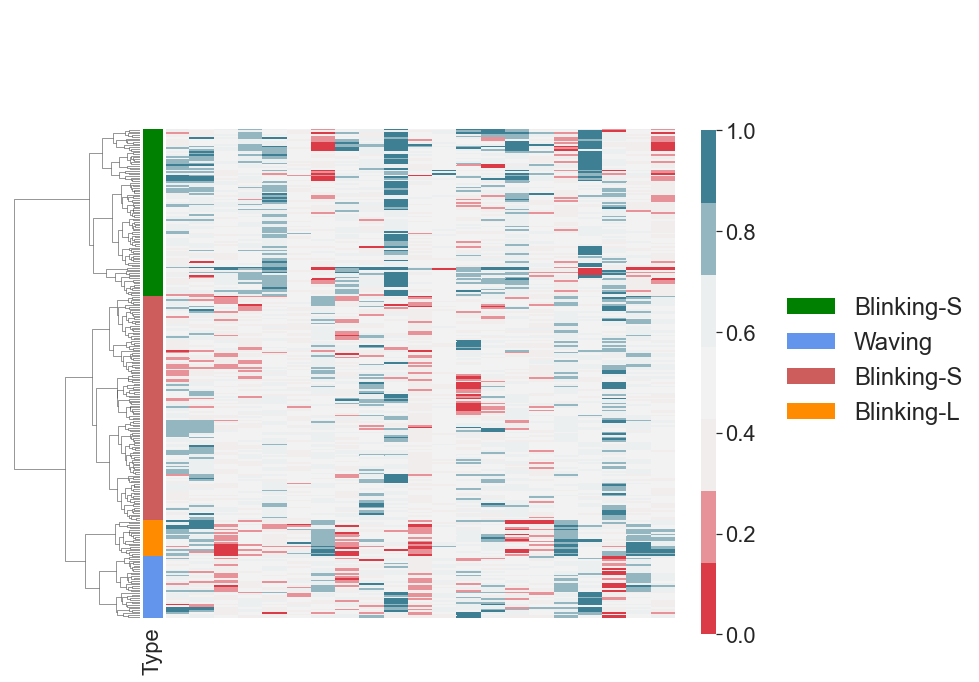

In [106]:
f=output_data
#row_c = dict(zip(f['Type'].unique(), ['mediumaquamarine','orange','orangered','mediumpurple','cornflowerblue']))
row_c = dict(zip(f['Type'].unique(), ['indianred','green','cornflowerblue','darkorange']))
sns.set(font_scale=2)
g=sns.clustermap(#figsize=(10,10),
               data=f.iloc[:,1:],
               method='ward',
               row_colors=f['Type'].map(row_c), 
               col_cluster=False,
               yticklabels=False,
               xticklabels=False,
               cbar_kws={
                           'orientation': 'vertical',
                           "ticks":np.arange(0,1.2,0.2),#color bar中刻度值范围和间隔
                           "format":"%.1f",#格式化输出color bar中刻度值
                           
                           'shrink':1 },
                   
                cbar_pos=(1, 0.092, 0.02, 0.7), #(left, bottom, width, height)
                cmap=sns.diverging_palette(10, 220, sep=80, n=7),
                #cmap=palettable.cartocolors.diverging.ArmyRose_7.mpl_colors
                #cmap='Blues'
                
              )
labels=['Blinking-S','Waving','Blinking-S','Blinking-L']
for i in range(f['Type'].unique().shape[0]):
    #label=f['Type'].unique()[i]
    #print(row_c[i])
    #print(labels[i])
    g.ax_col_dendrogram.bar(0, 0, color=row_c[i],
                            label=labels[i], linewidth=0)
g.ax_col_dendrogram.legend(loc=[1.2,-2.5], ncol=1,fontsize=24,frameon=False)
#plt.savefig('231 cluster-heatmap.eps',format='eps',dpi=600)
#plt.savefig('231 cluster-heatmap.png',dpi=600)

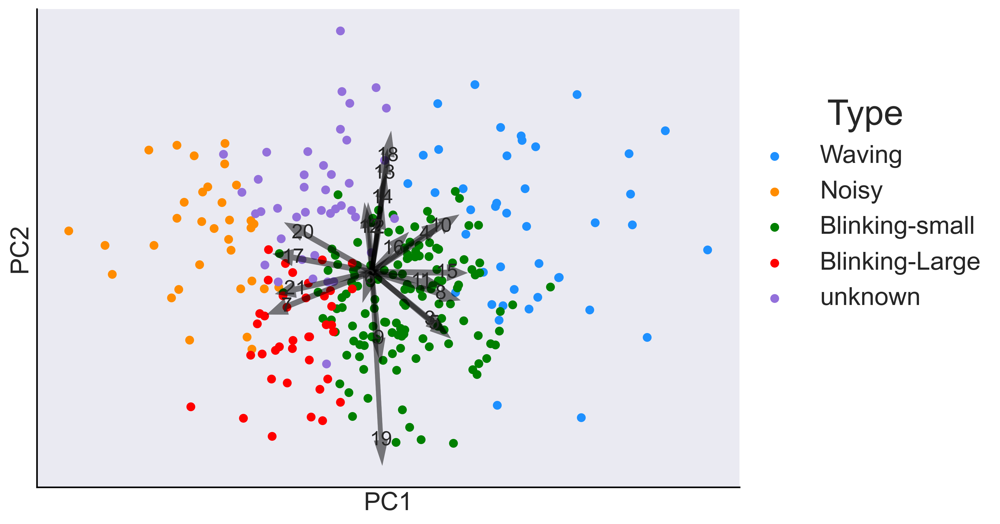

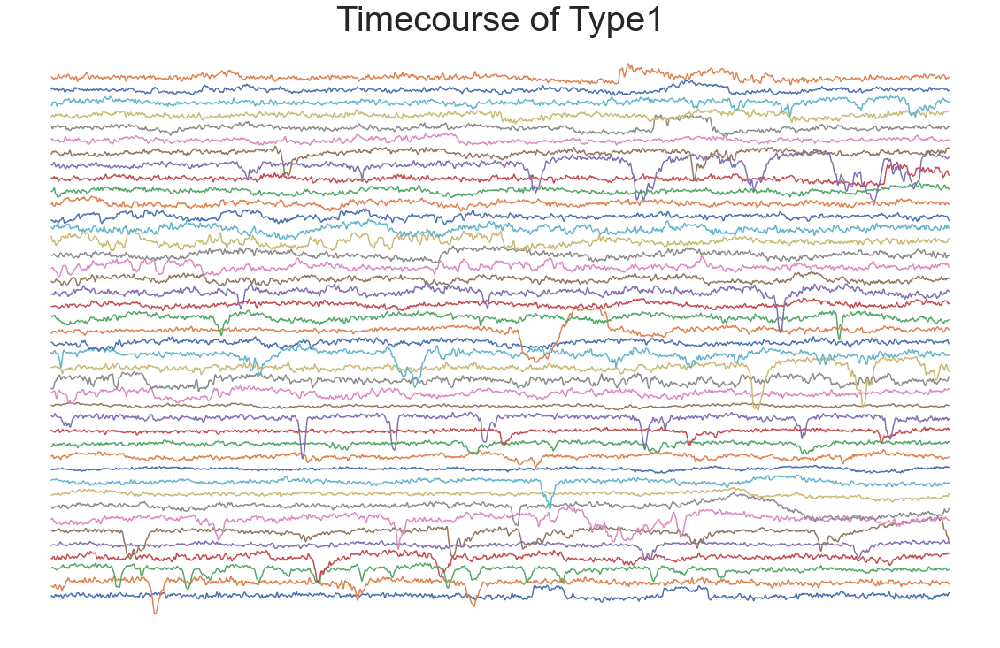

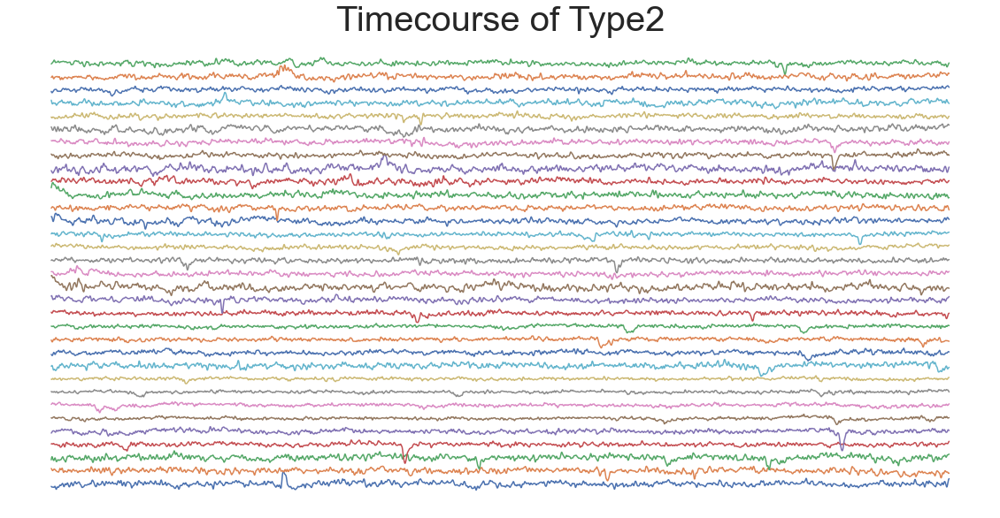

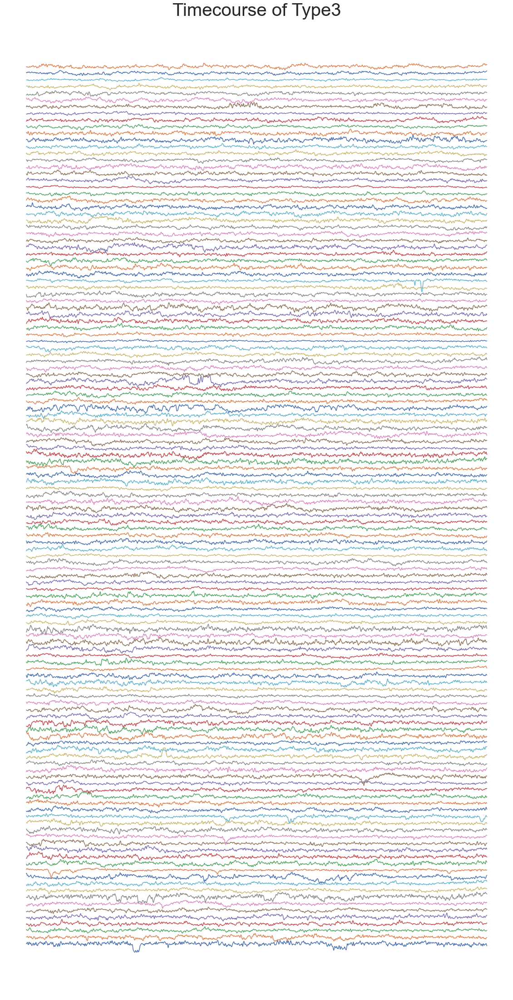

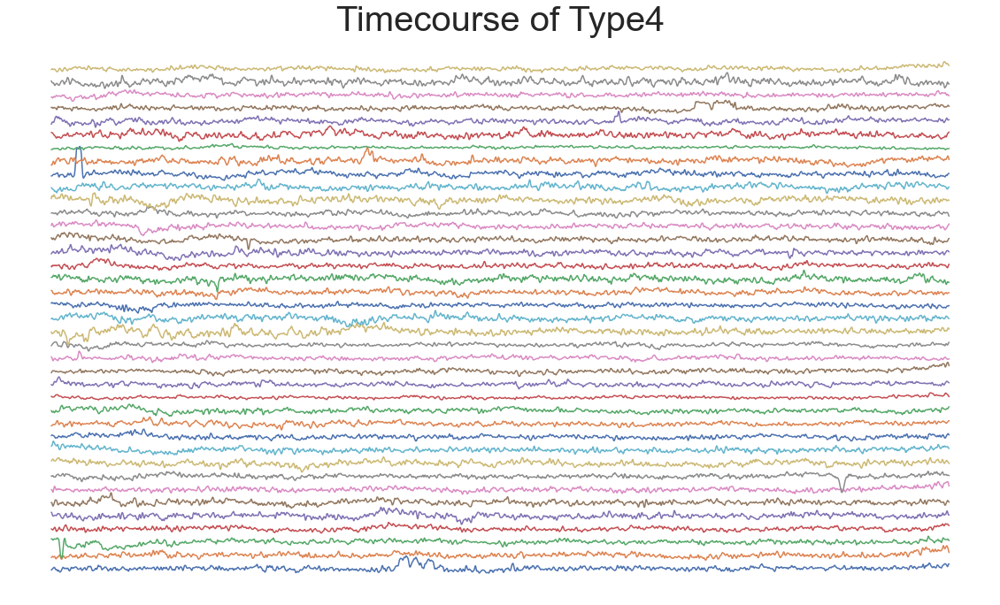

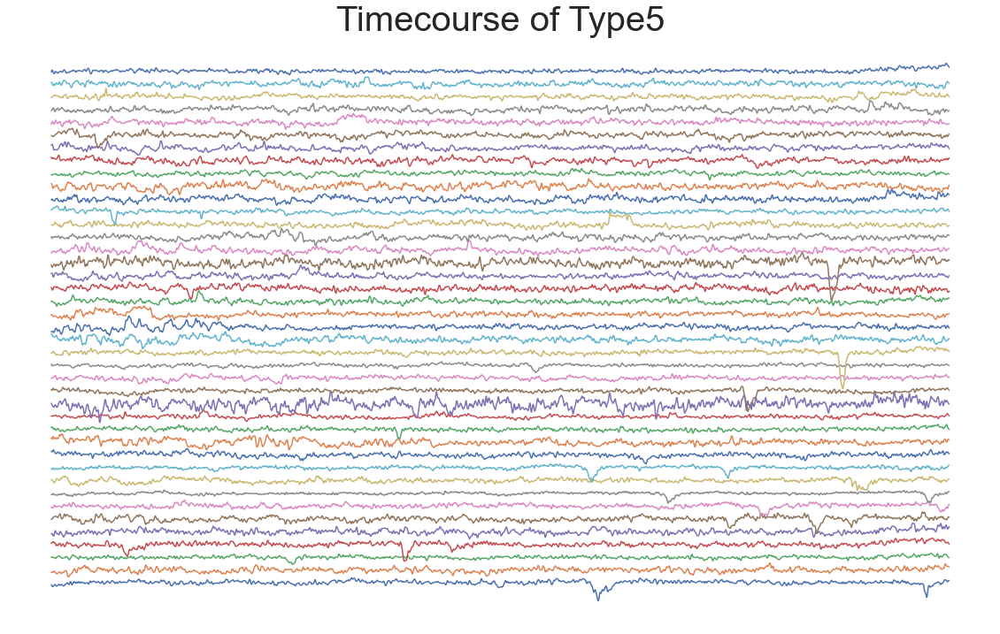

In [107]:
T=0.2
#from sklearn.cluster import AgglomerativeClustering
n_clusters=5
gm = GMM(n_components=n_clusters, random_state=0).fit(fb)
labels_=gm.predict(fb)

ts=tc_filt
pca = PCA(n_components=0.8)
new_pca = pd.DataFrame(pca.fit_transform(fb))
importance = pca.explained_variance_ratio_
c=pca.components_

output_data = pd.concat([ pd.Series(labels_, index=fb.index),fb], axis=1)   # Output with group information
output_data.columns = ['Type']+list(fb.columns)  # Rename columns
output_ts = pd.concat([pd.Series(labels_, index=ts.index),ts], axis=1)   # Output with group information
output_ts.columns = ['Type'] + list(ts.columns)   # Rename columns

#output_data.to_csv('fb with label.csv')
#output_ts.to_csv('Timeseries with label.csv')

title=['Waving','Noisy','Blinking-small','Blinking-Large','unknown']
color=['dodgerblue','darkorange','green','red','mediumpurple']
fig=plt.figure(dpi=300,figsize=(10,7))
ax=fig.add_subplot(111)
for i in range(n_clusters):
    t=new_pca[output_data['Type']==i]
    ax.scatter(t.iloc[:,0],t.iloc[:,1],label=title[i],marker='o',color=color[i])

plt.legend(fontsize=20,frameon=False,loc=[1,0.35],ncol=1,title='Type',title_fontsize=28,columnspacing=0.1)
plt.xticks([])
plt.yticks([])
#plt.title('PCA-231-Hierarchical')
kwargs={'linestyle':'-', 'lw':0.1, 'width':0.02}
for i in range(fb.columns.shape[0]):
    ax.arrow(0,0,c[0,i],c[1,i],alpha=0.5,ec='black',fc='black',**kwargs)
    ax.text(c[0,i],c[1,i],f'{i+1}', ha="center", va="center",fontsize=16)
#for i in [14,4,16,15]:
    #ax.arrow(1.5,-0.5,c[0,i]*0.7,c[1,i]*0.7,alpha=0.5,ec='black',fc='black',**kwargs)
    #ax.text(c[0,i]*0.7+1.5,c[1,i]*0.7-0.5,f'{i+1}', ha="center", va="center",fontsize=20)
ax.set_xlabel(f'PC1',fontsize=20)  
ax.set_ylabel(f'PC2',fontsize=20)
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
#plt.savefig('PCA of 231.png',dpi=600)
#plt.savefig('PCA of 231.eps',format='eps',dpi=600)
#ax.spines['left'].set_linewidth(3)
#ax.spines['bottom'].set_linewidth(3)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')

for i in range(n_clusters):
    g=output_ts[output_ts['Type']==i].iloc[:,1:]
    
    fig,ax=plt.subplots(figsize=(20,g.shape[0]*0.3))
    ax.plot(np.arange(g.shape[1])*T,g.T + np.arange(g.shape[0])/70)
    ax.set_title(f'Timecourse of Type{i+1}',fontsize=40)
    #ax.set_xlabel('Time(s)',fontsize=30)
    #ax.set_ylabel('Fluorescence df/F',fontsize=30)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.spines['left'].set_color('none')
    ax.spines['bottom'].set_color('none')
    ax.axis('off')

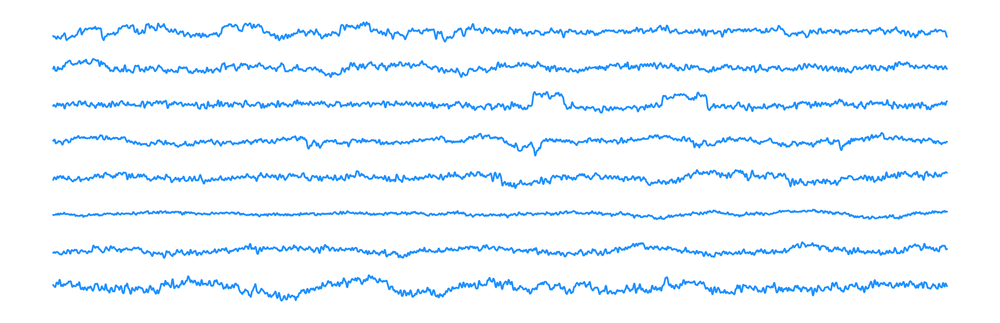

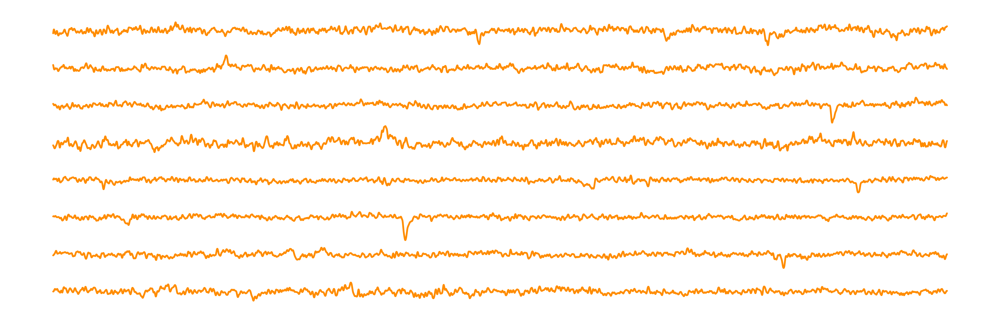

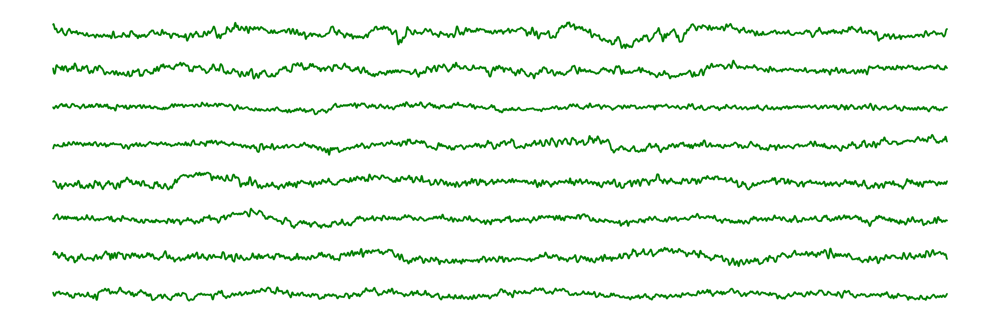

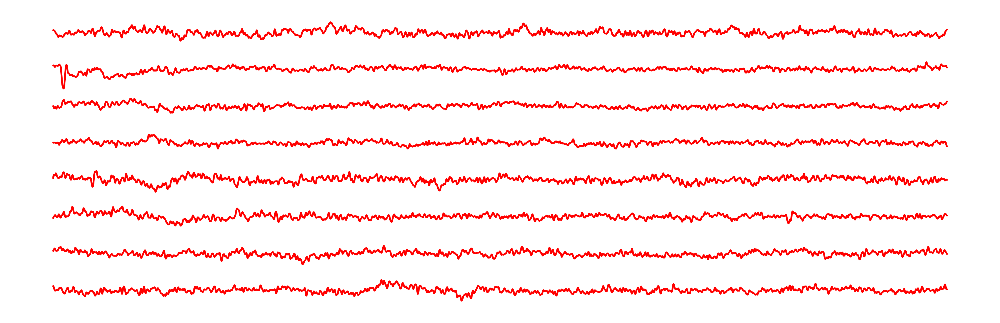

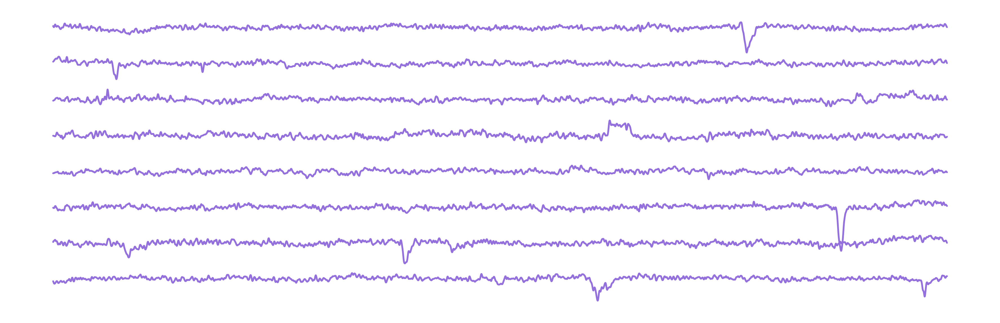

In [108]:
by=[fb.columns[17],fb.columns[14],fb.columns[2],fb.columns[15],fb.columns[14]]
a=[False,False,False,False,False]
for i in range(n_clusters):
    f=output_data[output_data['Type']==i].iloc[:,1:]
    f=f.sort_values(by=by[i],axis=0,ascending=a[i])
    t=output_ts.iloc[f.index[0:8],1:]
    T=0.2
    ts=np.array(t)
    fig,ax=plt.subplots(figsize=(15,0.6*t.shape[0]),dpi=300)
    ax.plot(np.arange(ts.shape[1])*T,ts.T+ np.arange(ts.shape[0])/30,color=color[i])
    #ax.set_title(title[i],fontsize=20)
    #ax.set_xlabel('Time(s)')
    #ax.set_ylabel('Fluorescence df/F')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.spines['left'].set_color('none')
    ax.spines['bottom'].set_color('none')
    ax.axis('off')
    #plt.savefig('Reps-'+title[i]+'.png',dpi=600)

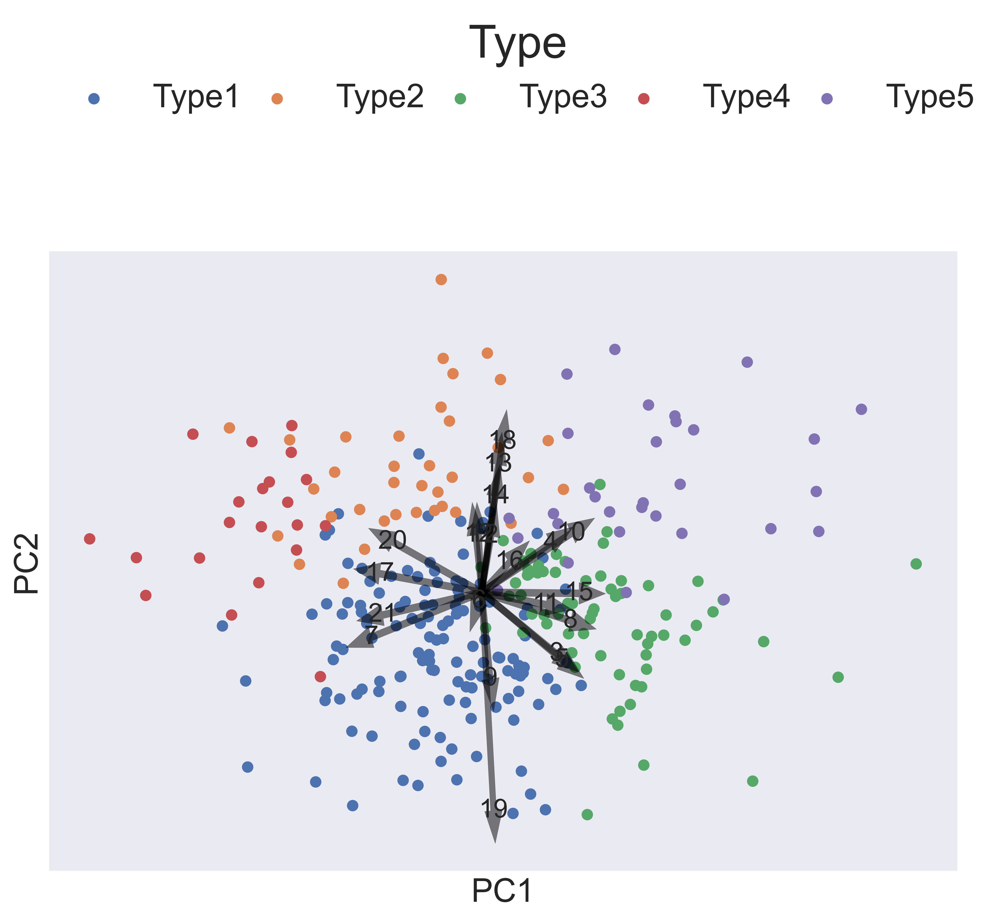

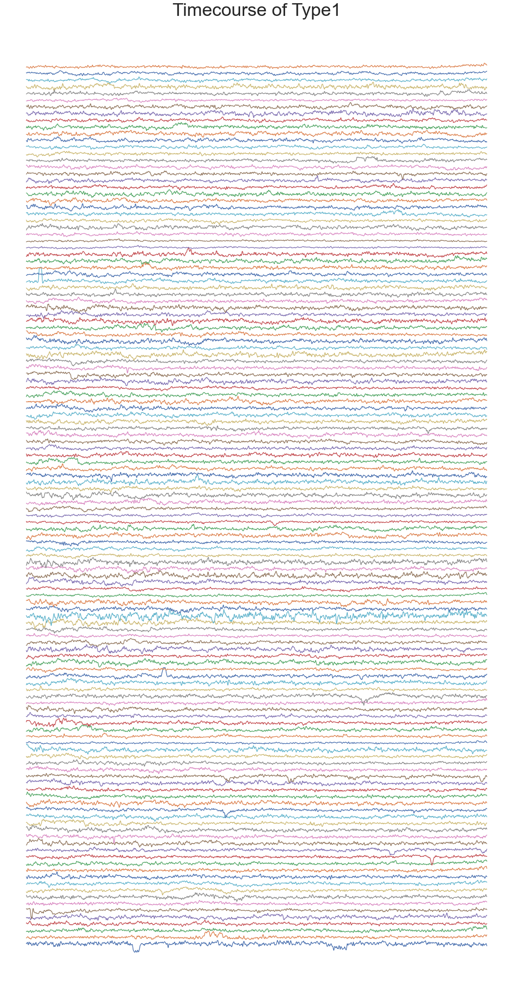

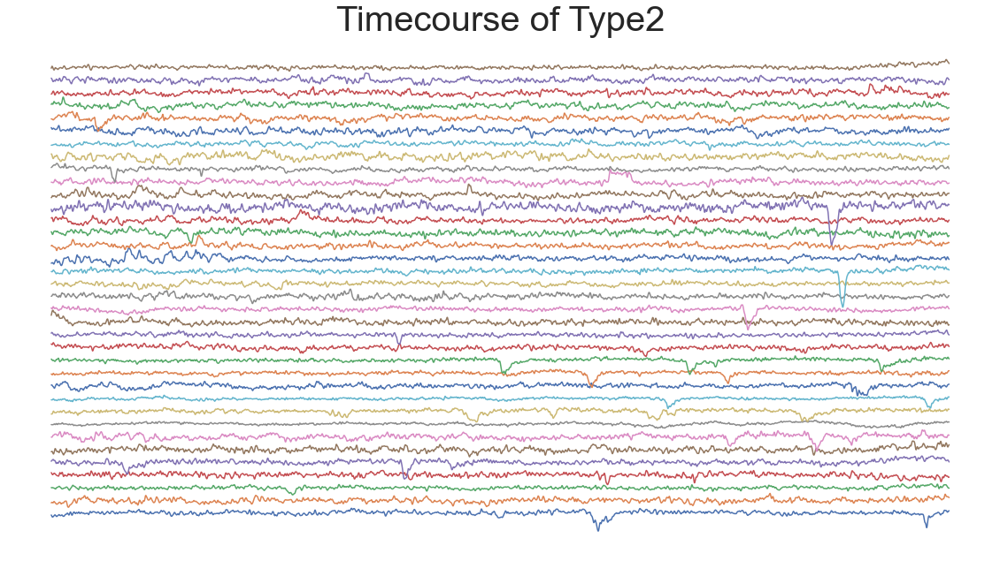

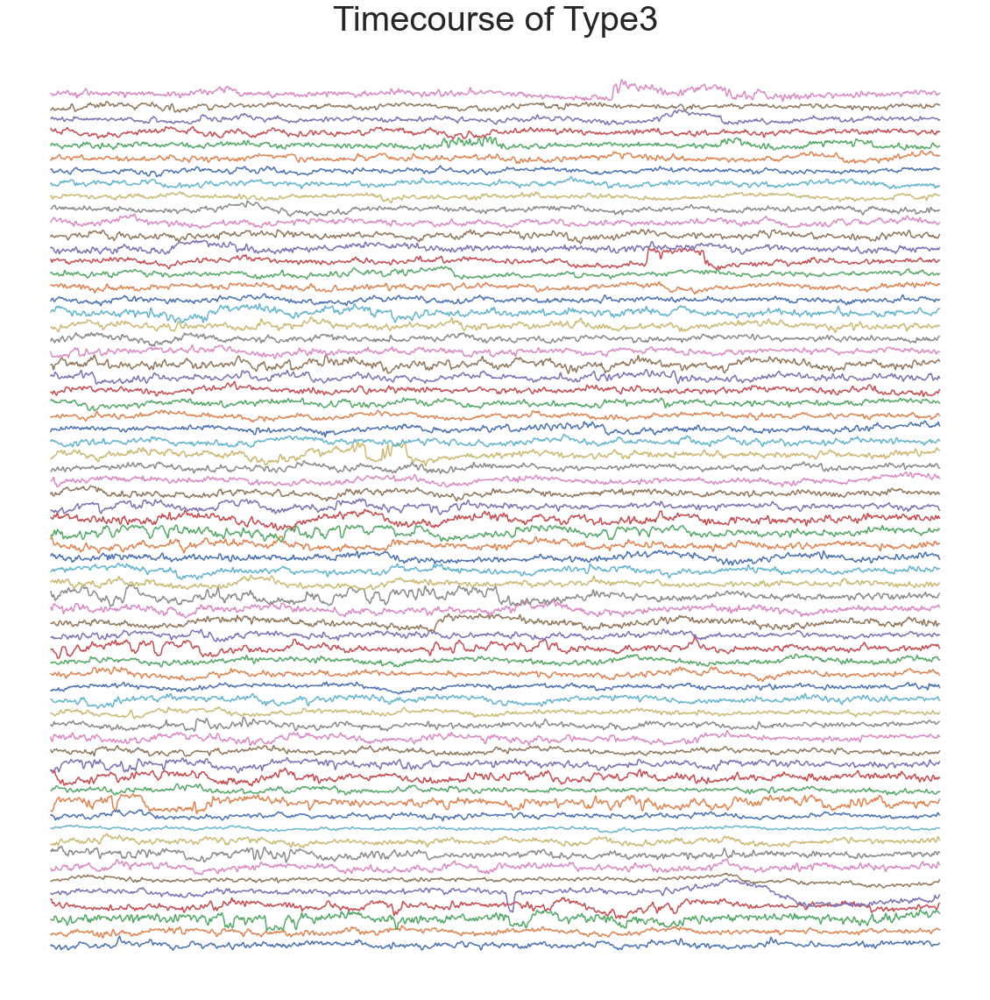

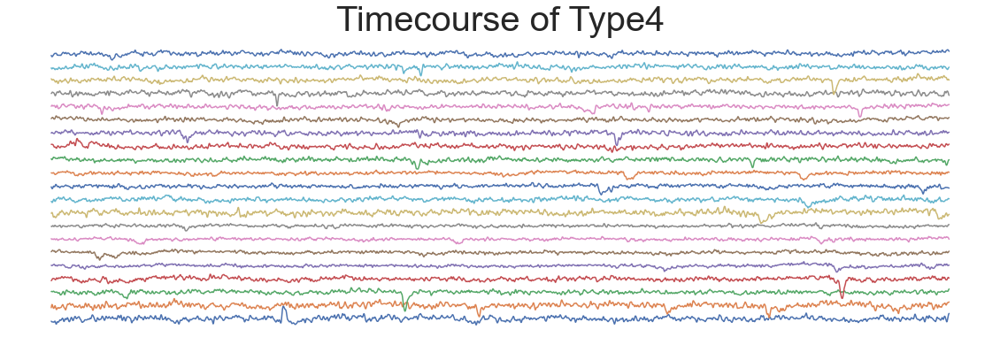

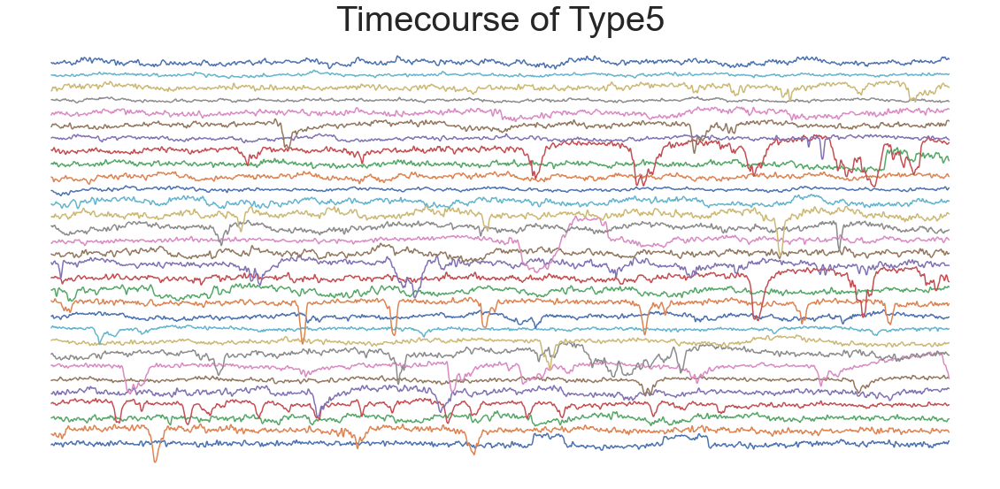

In [109]:
# Hierarchical clustering
T=0.2
from sklearn.cluster import AgglomerativeClustering

n_clusters=5
clustering = AgglomerativeClustering(linkage='ward',n_clusters=n_clusters).fit(fb)

clustering.labels_

ts=tc_filt
pca = PCA(n_components=0.8)
new_pca = pd.DataFrame(pca.fit_transform(fb))
importance = pca.explained_variance_ratio_
c=pca.components_

output_data = pd.concat([ pd.Series(clustering.labels_, index=fb.index),fb], axis=1)   # Output with group information
output_data.columns = ['Type']+list(fb.columns)  # Rename columns
output_ts = pd.concat([pd.Series(clustering.labels_, index=ts.index),ts], axis=1)   # Output with group information
output_ts.columns = ['Type'] + list(ts.columns)   # Rename columns

#output_data.to_csv('Features with label.csv')
#output_ts.to_csv('Timeseries with label.csv')

fig=plt.figure(figsize=(10,7),dpi=600)
ax=fig.add_subplot(111)
title=['Waving','Noisy','Blinking-S','Blinking-L','Quiet']
#title=['Quiet','Waving','Noisy','Blinking-S','Blinking-L']
color=['cornflowerblue','darkorange','green','indianred','mediumpurple']
for i in range(n_clusters):
    t=new_pca[output_data['Type']==i]
    ax.scatter(t.iloc[:,0],t.iloc[:,1],label=f'Type{i+1}',marker='o')

plt.legend(fontsize=20,frameon=False,loc=[0,1.2],ncol=5,title='Type',title_fontsize=28,columnspacing=0.1)
plt.xticks([])
plt.yticks([])
#plt.title('PCA-231-Hierarchical')
kwargs={'linestyle':'-', 'lw':0.1, 'width':0.02} 
for i in range(c.shape[1]):
    ax.arrow(0,0,c[0,i],c[1,i],alpha=0.5,ec='black',fc='black',**kwargs)
    ax.text(c[0,i],c[1,i],f'{i+1}', ha="center", va="center",fontsize=16)
ax.set_xlabel(f'PC1',fontsize=20)  
ax.set_ylabel(f'PC2',fontsize=20)
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
#plt.savefig('PCA of 231.png',dpi=1200)
#ax.spines['left'].set_linewidth(5)
#ax.spines['bottom'].set_linewidth(4)

# Plot the traces in each type
for i in range(n_clusters):
    g=output_ts[output_ts['Type']==i].iloc[:,1:]
    
    fig,ax=plt.subplots(figsize=(20,g.shape[0]*0.3))
    ax.plot(np.arange(g.shape[1])*T,g.T + np.arange(g.shape[0])/70)
    ax.set_title(f'Timecourse of Type{i+1}',fontsize=40)
    #ax.set_xlabel('Time(s)',fontsize=30)
    #ax.set_ylabel('Fluorescence df/F',fontsize=30)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.spines['left'].set_color('none')
    ax.spines['bottom'].set_color('none')
    ax.axis('off')

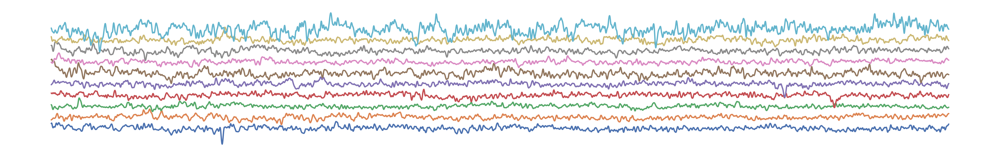

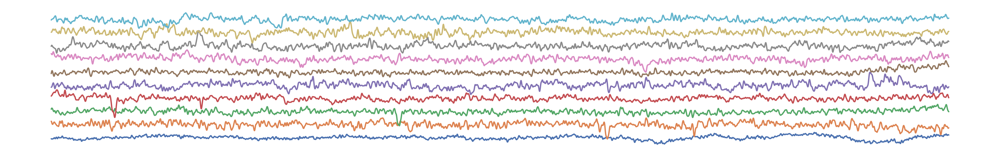

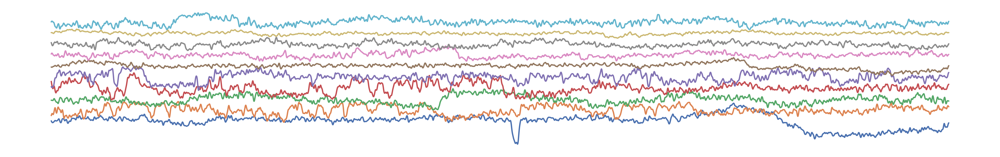

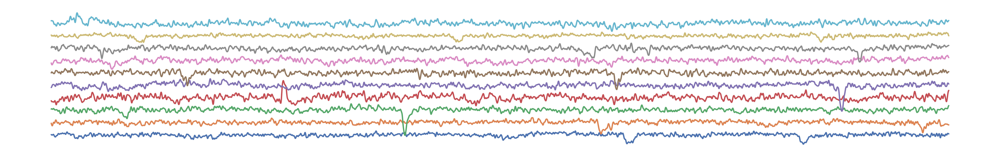

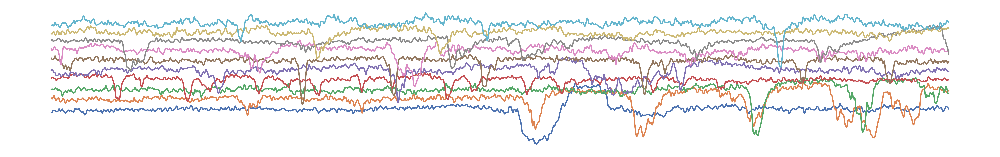

In [110]:
by=[fb.columns[19],fb.columns[3],fb.columns[4],fb.columns[17],fb.columns[14],fb.columns[16]]
a=[False,True,False,False,False,False]
for i in range(n_clusters):
    f=output_data[output_data['Type']==i].iloc[:,1:]
    f=f.sort_values(by=by[i],axis=0,ascending=a[i])
    t=output_ts.iloc[f.index[0:10],1:]
    T=0.2
    ts=np.array(t)
    fig,ax=plt.subplots(figsize=(20,0.3*t.shape[0]),dpi=600)
    ax.plot(np.arange(ts.shape[1])*T,ts.T+ np.arange(ts.shape[0])/100)
    #ax.set_title(title[i],fontsize=20)
    #ax.set_xlabel('Time(s)')
    #ax.set_ylabel('Fluorescence df/F')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.spines['left'].set_color('none')
    ax.spines['bottom'].set_color('none')
    ax.axis('off')
    #plt.savefig('Reps-'+title[i]+'.png',dpi=600)